In [1]:
%load_ext autoreload
%autoreload 2

# Dataset explanation

For our project, we've selected a dataset constructed from internal email exchanges within a large European research institution. The dataset captures anonymized records of all emails sent between members of the institution. In the corresponding network, an edge
$(u,v)$ exists whenever person $u$ sent at least one email to person $v$. Because the data only includes communication among institutional members, it represents a closed network without any external incoming or outgoing messages.

An important feature of this dataset is the availability of “ground-truth” community labels. Each individual belongs to exactly one of the institution’s 42 departments, providing predefined community memberships that can be used to evaluate our community detection methods.

The dataset can be accessed from the following link (https://snap.stanford.edu/data/email-Eu-core.html), or downloaded and put inside the correct folder by executing the following cell.



In [ ]:
from utils import download_data

files = [
    "email-Eu-core.txt.gz",
    "email-Eu-core-department-labels.txt.gz"
]

download_data('twitch', "https://github.com/Carda01/community_detection/releases/download/1.0/", ['twitch_data.zip'], category='twitch')
download_data('email', "https://snap.stanford.edu/data/", files, category='email')

# Preliminary analysis

For the following preliminary analysis we made the graph undirected, so as long as there is an edge between u and v (no matter the direction), in the newly built undirected graph there will be an edge between u and v. Also we've removed from the graph those nodes which have just self loops and no other edges to other nodes.


In [2]:
from utils import *

G = load_email()
show_mail_graph(G, k_core=5)

Calculating and adding node attribute 'degree'...


alt.LayerChart(...)

### Spy Plot

The sparsity plot (spyplot) of the adjacency matrix with the nodes ordered by their department is a sanity check.

If we get diagonal blocks it means that people inside their department sends each other a lot of mails, while they tend to send few to people of other departments.
And this is actually what we get. At the same time, there are some people (from departments 32-37 and especially department 36) who sends email to all the people. Our hypothesis is that they are the
managers or system admin department. We can already predict that it will be hard for these departments to separate them into their respective communities.
Additionally, we can notice that the communities vary drastically in size, and some are very small, like the 18th or the 12th.

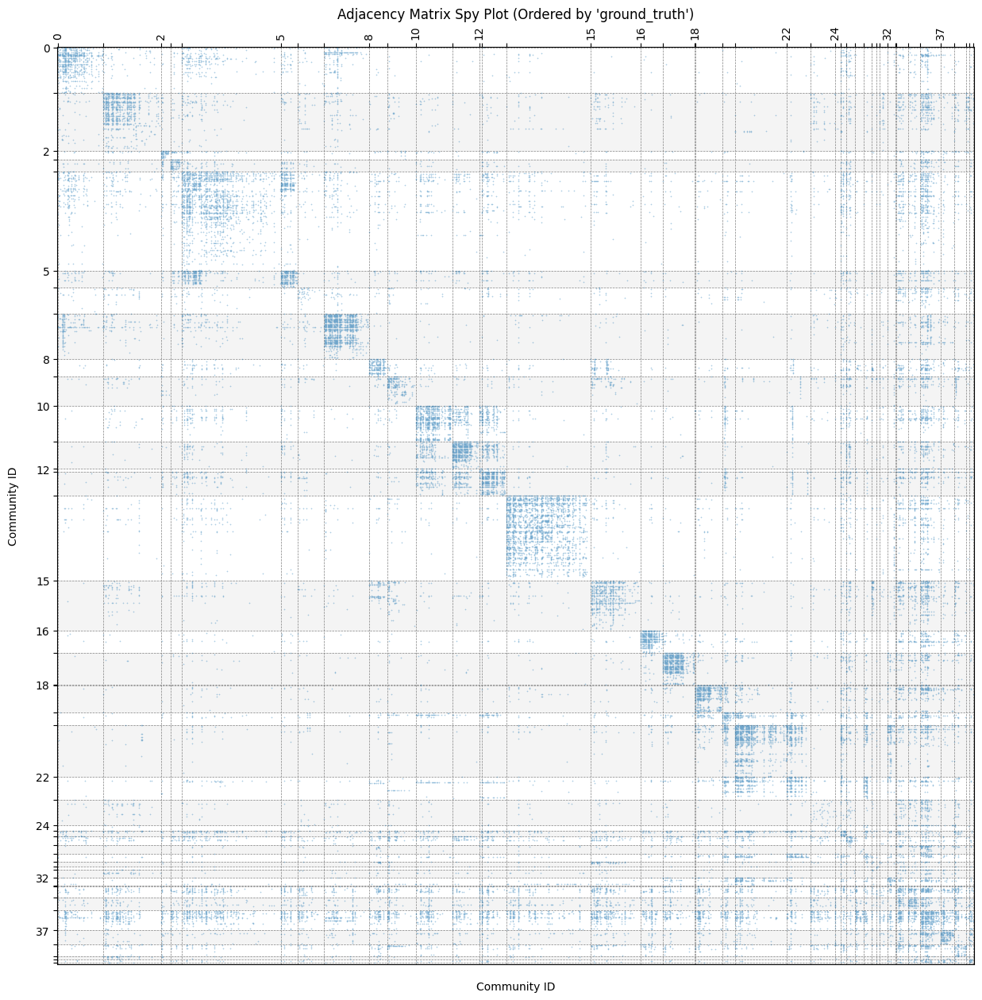

In [4]:
from utils import *

spy_plot_adjacency(G)

### General statistics
From the values of the diameter and the avg shortest path length, we can say that the network exhibits the classic "small-world" property. The degree distribution is
heavily right-skewed. It also indicates the presence of few highly connected nodes (hubs) whose degrees extend towards 350. The network's communication flow is largely
driven by these hubs (likely managers, system admins, or highly collaborative individuals), while the majority of nodes have lower connectivity.

The Clique Size (k) Distribution plot shows a roughly normal (bell-shaped) distribution centered around $k \approx 9$ to 10. This suggests a strong, consistent tendency
for nodes to organize into tightly connected, medium-sized groups (cliques). This is a strong indicator of robust community structure. Also, this can be noticed by the
high value of the clustering coefficient. In a random graph it is rougly equal to the density, but here we have $0.4 \gg 0.03$.


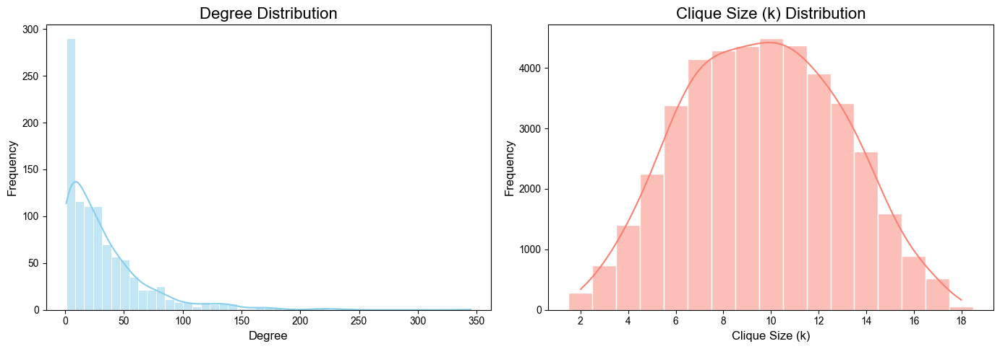

Number of nodes: 986
Number of edges: 16064
Average degree: 32.58
Density: 0.0331
Average clustering coefficient: 0.4071
Graph is connected.
Radius: 4
Diameter: 7
Average shortest path length: 2.59


In [5]:
hist_degrees_cliques(G)
summary_stats(G)

### Centrality Measures
bla bla bla fill this


In [20]:
import networkx as nx
from utils import *

centralities = calculate_centrality_metrics(G, [nx.pagerank, nx.betweenness_centrality, nx.closeness_centrality, nx.laplacian_centrality, nx.eigenvector_centrality])

Calculating and adding node attribute 'pagerank'...
Calculating and adding node attribute 'betweenness_centrality'...
Calculating and adding node attribute 'closeness_centrality'...
Calculating and adding node attribute 'laplacian_centrality'...
Calculating and adding node attribute 'eigenvector_centrality'...


In [7]:
show_top_nodes_by_centrality(centralities, 'betweenness_centrality')

,Node,Ground Truth,betweenness_centrality
160,160,36,0.090821
86,86,36,0.039261
5,5,25,0.032203
82,82,36,0.028967
121,121,36,0.028927
107,107,36,0.025289
13,13,26,0.024483
377,377,7,0.024078
62,62,36,0.023387
64,64,25,0.022778


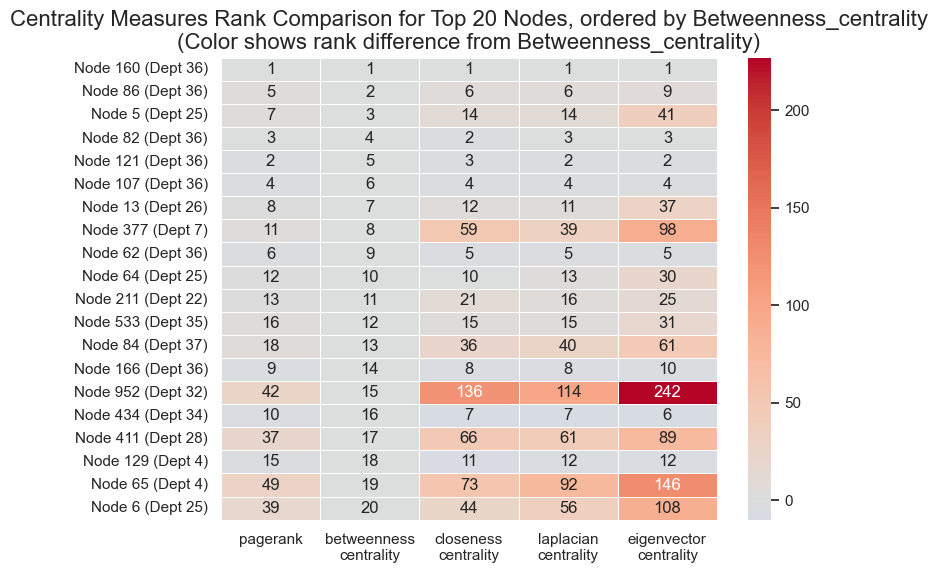

In [8]:
visualize_top_n_centrality(centralities, 'betweenness_centrality')

In [9]:
generic_show(G, node_color='betweenness_centrality',
             node_size='pagerank',
             node_tooltip=['ground_truth', 'degree', 'pagerank', 'betweenness_centrality'],
             k_core=20,
             layout_func=nx.spiral_layout)

alt.LayerChart(...)

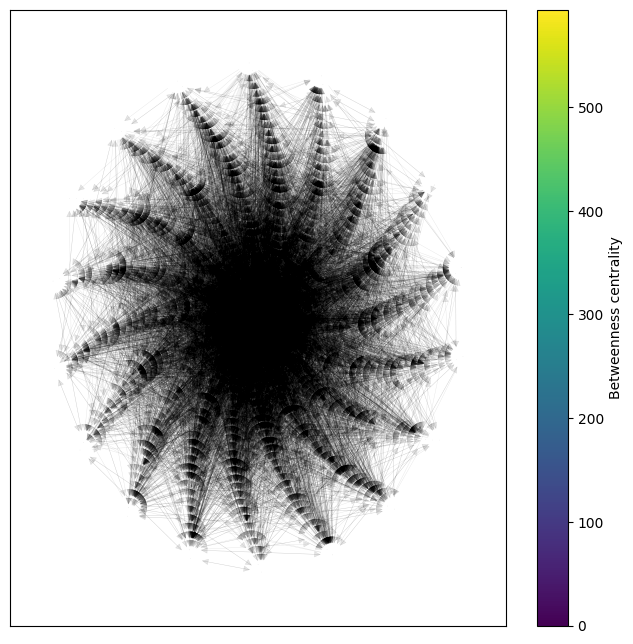

In [21]:
generic_show_static(G, node_color='betweenness_centrality',
             node_size='pagerank',
             k_core=20,
             layout_func=nx.spiral_layout)


# Community detection
bla bla bla fill this


# Influence Maximization
We consider a scenario in which the EU research institution aims to identify internal security vulnerabilities. If a malicious actor compromises a single user's email account, they can leverage established organizational trust to propagate malicious content to colleagues in a cascading attack. Consequently, our objective is to identify the users who represent the highest risk, specifically, those whose compromise would result in the widest dissemination of the threat. Formally, this is an Influence Maximization problem, where we aim to identify the optimal seed set S that maximizes the spread of influence across the network

In [3]:
G = load_email(directed=True)

In [6]:
from influence_maximization import *

P_INFLUENCE = 0.05
MC_SIMULATIONS = 50
BUDGET = 10

seeds, final_spread = greedy(G, k=BUDGET, p=P_INFLUENCE, mc=MC_SIMULATIONS)

print("-" * 50)
print(f"Optimal Seed Set S: {seeds}")
print(f"Estimated Total Spread: {final_spread:.2f} users")
print("-" * 50)


[Starting Greedy] Target seeds: 10 | Simulations: 50 | p: 0.05
  > Finding seed 1/10 (evaluating 986 nodes)...


  0%|          | 0/986 [00:00<?, ?it/s]

  > Seed 1 found: Node 105 (Marginal Gain: 469.76) | Total Spread: 469.76
  > Finding seed 2/10 (evaluating 985 nodes)...


  0%|          | 0/985 [00:00<?, ?it/s]

  > Seed 2 found: Node 442 (Marginal Gain: 3.70) | Total Spread: 473.46
  > Finding seed 3/10 (evaluating 984 nodes)...


  0%|          | 0/984 [00:00<?, ?it/s]

  > Seed 3 found: Node 251 (Marginal Gain: 0.84) | Total Spread: 474.30
  > Finding seed 4/10 (evaluating 983 nodes)...


  0%|          | 0/983 [00:00<?, ?it/s]

  > Seed 4 found: Node 968 (Marginal Gain: 1.28) | Total Spread: 475.58
  > Finding seed 5/10 (evaluating 982 nodes)...


  0%|          | 0/982 [00:00<?, ?it/s]

  > No further node could improve the spread.
--------------------------------------------------
Optimal Seed Set S: [105, 442, 251, 968]
Estimated Total Spread: 475.58 users
--------------------------------------------------


In [7]:
from influence_maximization import *
G_infected = simulate_and_tag_infection(G, seeds, p=P_INFLUENCE)

In [10]:
generic_show(G_infected, node_color='infected', node_size=15, node_tooltip=['infected', 'ground_truth'], k_core=5)

alt.LayerChart(...)

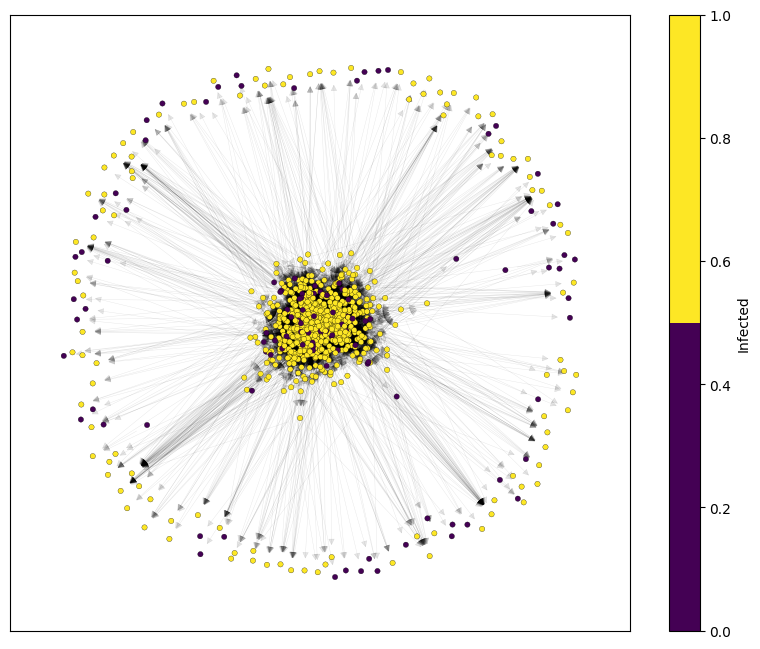

In [19]:
from utils import *
generic_show_static(G_infected, node_color='infected', node_size=15, k_core=0, width=10, height=8)